In [1]:
import os
import random
import numpy as np
from tqdm import tqdm
import shutil
from IPython.display import HTML

import matplotlib
import matplotlib.pyplot as plt
import matplotlib.animation as animation
matplotlib.rcParams['figure.figsize'] = [5, 5]
matplotlib.rcParams['figure.dpi'] = 200

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.nn import init

import torchvision
import torchvision.transforms as transforms
import torchvision.utils as vutils

from data_helper_color_map import UnlabeledDataset, LabeledDataset
from helper import collate_fn, draw_box

In [2]:
random.seed(0)
np.random.seed(0)
torch.manual_seed(0);

device = ("cuda:0" if torch.cuda.is_available() else "cpu")

In [3]:
data_dir = '/home/alexander/data'
annotation_csv = '/home/alexander/data/annotation.csv'

resume_training_from_checkpoint = True
load_checkpoint_path = 'training_checkpoints/GANLossBCE_L1Loss_64feat_colormap_epoch_0to100_checkpoint_lowerLR.pth.tar'
save_checkpoint_path = 'training_checkpoints/GANLossBCE_L1Loss_64feat_colormap_epoch_0to100_checkpoint_lowerLR.pth.tar'

In [4]:
def save_checkpoint(fpath, state):
    torch.save(state, fpath)
    
def print_sys_mem_usage():
    print("Memory usage (RAM):\n")
    !free -h
    print("\nGPU Memory Usage:\n")
    !nvidia-smi --query-gpu=memory.used --format=csv
    !nvidia-smi --query-gpu=memory.total --format=csv
    print("\n")
    
def print_train_stats(epoch, n_epochs, i, n_batches, loss_d_total, loss_g_total, d_real_mean, d_gen_mean_pre, d_gen_mean_post):
    print('Epoch: [%d/%d]\tBatch: [%d/%d]\n' % (epoch + 1, n_epochs, i, n_batches),
          'Loss_D: %.4f\tLoss_G: %.4f\n' % (loss_d_total.item(), loss_g_total.item()),
          'D(real): %.4f  ||  D(gen) Pre-step: %.4f  ||  D(gen) Post-step: %.4f\n' %
          (d_real_mean, d_gen_mean_pre, d_gen_mean_post))

### Set Initial Parameters

In [5]:
batch_size = 16

### Create Dataset and Dataloader

In [6]:
unlabeled_scene_index = np.arange(106)
labeled_scene_index_train = np.arange(106, 130)
labeled_scene_index_test = np.arange(130, 134)

In [7]:
labeled_trainset = LabeledDataset(image_folder=data_dir,
                                  annotation_file=annotation_csv,
                                  scene_index=labeled_scene_index_train,
                                  img_transform=transforms.Compose([transforms.Resize((256,256)),
                                                                    transforms.ToTensor(),
                                                                    transforms.Normalize(mean=(0.5,), std=(0.5,))
                                                                   ]),
                                  map_transform=transforms.Compose([transforms.ToPILImage(),
                                                                    transforms.Resize(256),
                                                                    transforms.ToTensor()
                                                                   ]),
                                  extra_info=True
                                 )

trainloader = torch.utils.data.DataLoader(labeled_trainset,
                                          batch_size=batch_size,
                                          shuffle=True,
                                          num_workers=2,
                                          collate_fn=collate_fn,
                                          pin_memory=True)

In [8]:
labeled_trainset[1][0].size()

torch.Size([18, 256, 256])

In [9]:
for images, road_maps in trainloader:
    print(road_maps.size())
    break

torch.Size([16, 3, 256, 256])


### Define models

In [10]:
class ResnetBlock(nn.Module):
    """
    Define a Resnet block
    A resnet block is a conv block with skip connections
    Original Resnet paper: https://arxiv.org/pdf/1512.03385.pdf
    """
    def __init__(self, dim):
        """
        Parameters:
            dim (int)           -- the number of channels in the conv layer.
            padding_type (str)  -- the name of padding layer: reflect | replicate | zero
            use_dropout (bool)  -- if use dropout layers.
            use_bias (bool)     -- if the conv layer uses bias or not
        """
        super(ResnetBlock, self).__init__()
        self.resnet_block = nn.Sequential(nn.Conv2d(dim, dim, kernel_size=3, padding=1),
                                          nn.BatchNorm2d(dim),
                                          nn.ReLU(True),
                                          nn.Dropout(0.5),
                                          nn.Conv2d(dim, dim, kernel_size=3, padding=1),
                                          nn.BatchNorm2d(dim)
                                         )
        
    def forward(self, x):
        return x + self.resnet_block(x)  # add skip connections

In [11]:
class Generator(nn.Module):
    """
    RESNET-based generator that consists of Resnet blocks + downsampling/upsampling operations.
    """
    def __init__(self, in_ch, out_ch, ngf, n_blocks=6, init_gain=0.02):
        """
        Parameters:
            in_ch (int)         -- the number of channels in input images
            out_ch (int)        -- the number of channels in output images
            ngf (int)           -- the number of filters in the last conv layer
            n_blocks (int)      -- the number of ResNet blocks
            padding_type (str)  -- the name of padding layer in conv layers: reflect | replicate | zero
        """        
        assert(n_blocks >= 0)
        super(Generator, self).__init__()
        
        self.model = nn.Sequential(
            nn.ReflectionPad2d(3),
            
            nn.Conv2d(in_ch, ngf, kernel_size=7, padding=0),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            
            nn.Conv2d(ngf, ngf * 2, kernel_size=3, stride=2, padding=1),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            
            nn.Conv2d(ngf * 2, ngf * 4, kernel_size=3, stride=2, padding=1),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            
            ResnetBlock(ngf * 4),  #1
            ResnetBlock(ngf * 4),  #2
            ResnetBlock(ngf * 4),  #3
            ResnetBlock(ngf * 4),  #4
            ResnetBlock(ngf * 4),  #5
            ResnetBlock(ngf * 4),  #6
            ResnetBlock(ngf * 4),  #7
            ResnetBlock(ngf * 4),  #8
            ResnetBlock(ngf * 4),  #9

            nn.ConvTranspose2d(ngf * 4, int(ngf * 2), kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(int(ngf * 2)),
            nn.ReLU(True),
            
            nn.ConvTranspose2d(ngf * 2, int(ngf), kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(int(ngf)),
            nn.ReLU(True),

            nn.ReflectionPad2d(3),
            nn.Conv2d(ngf, out_ch, kernel_size=7, padding=0),
            nn.Tanh()
        )
        
    def forward(self, x):
        return self.model(x)

In [12]:
class Discriminator(nn.Module):
    def __init__(self, in_ch, ndf=64, n_layers=3):  
        super(Discriminator, self).__init__()
        
        self.block1 = nn.Sequential(nn.Conv2d(in_ch, ndf, kernel_size=4, stride=2, padding=1),
                                    nn.LeakyReLU(0.2, True)
                                   )
        
        nf_mult = 1
        nf_mult_prev = 1
        sequence2 = []        
        for n in range(1, n_layers):  # gradually increase the number of filters
            nf_mult_prev = nf_mult
            nf_mult = min(2 ** n, 8)
            sequence2 += [nn.Conv2d(ndf * nf_mult_prev, ndf * nf_mult, kernel_size=4, stride=2, padding=1),
                         nn.BatchNorm2d(ndf * nf_mult),
                         nn.LeakyReLU(0.2, True)
                         ]
        self.block2 = nn.Sequential(*sequence2)
        
        sequence3 = []
        nf_mult_prev = nf_mult
        nf_mult = min(2 ** n_layers, 8)
        sequence3 += [nn.Conv2d(ndf * nf_mult_prev, ndf * nf_mult, kernel_size=4, stride=1, padding=1),
                     nn.BatchNorm2d(ndf * nf_mult),
                     nn.LeakyReLU(0.2, True)
                     ]
        self.block3 = nn.Sequential(*sequence3)
        
        self.model = nn.Sequential(self.block1,
                                   self.block2,
                                   self.block3,
                                   nn.Conv2d(ndf * nf_mult, 1, kernel_size=4, stride=1, padding=1)
                                  )
        
    def forward(self, x):
        return self.model(x)

In [13]:
# # Sanity check - dimensions of inputs and outputs to both networks.

# test = torch.zeros([batch_size, 18, 256, 256])
# print("Input to generator:\t", test.size())

# test_generator = Generator(in_ch, out_ch, ngf, n_blocks=n_blocks_g, init_gain=0.02)
# test_result_g = test_generator(test)
# print("\nOutput of generator:\t", test_result_g.size())

# test_d_input = torch.cat((test_result_g, test), 1)
# print("\nInput to discriminator:\t", test_d_input.size())

# test_discriminator = Discriminator(in_ch + out_ch, ndf=ndf, n_layers=n_layers_d)
# test_result_d = test_discriminator(test_d_input)
# print("\nOutput of discriminator:", test_result_d.size())

In [14]:
class GANLoss(nn.Module):
    """
    The GANLoss class abstracts away the need to create the target label tensor
    that has the same size as the input.
    """
    def __init__(self, gan_mode, real_label=1.0, gen_label=0.0):
        """
        Parameters:
            gan_mode (str) - - the type of GAN objective. It currently supports vanilla, lsgan, and wgangp.
            target_real_label (bool) - - label for a real image
            target_gen_label (bool) - - label of a generated image
        Note: Do not use sigmoid as the last layer of Discriminator.
        LSGAN needs no sigmoid. vanilla GANs will handle it with BCEWithLogitsLoss.
        """
        super(GANLoss, self).__init__()
        
        self.gan_mode = gan_mode
        self.real_label = real_label
        self.gen_label = gen_label
        
        if gan_mode == 'LS':
            self.loss = nn.MSELoss().to(device)
        elif gan_mode == 'BCE':
            self.loss = nn.BCEWithLogitsLoss().to(device)

    def get_target_tensor(self, output, target_is_real):
        # Create label tensors with same size as the discriminator output.
        if target_is_real:
            if "cuda" in device:
                target_tensor = torch.cuda.FloatTensor([self.real_label])
            else:
                target_tensor = torch.Tensor([self.real_label])
        else:
            if "cuda" in device:
                target_tensor = torch.cuda.FloatTensor([self.gen_label])
            else:
                target_tensor = torch.Tensor([self.gen_label])
                
        return target_tensor.expand_as(output)

    def __call__(self, output, target_is_real):
        target_tensor = self.get_target_tensor(output, target_is_real)
        loss = self.loss(output, target_tensor)
        return loss

In [15]:
def init_weights(m):  # define the initialization function
    classname = m.__class__.__name__
    if hasattr(m, 'weight') and (classname.find('Conv') != -1 or classname.find('Linear') != -1):
        init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm2d') != -1:  # BatchNorm Layer's weight is not a matrix; only normal distribution applies.
        init.normal_(m.weight.data, 1.0, 0.02)
        init.constant_(m.bias.data, 0.0)

### Train

In [16]:
update_stats_rate = 25
debug_mem_usage = False
losses_g = []
losses_d = []
intermediate_images = []

In [17]:
in_ch = 18
out_ch = 3
ngf = 64
ndf = 64
n_blocks_g = 9
n_layers_d = 3

start_epoch = 0
n_epochs = 100
lr_g = 0.00005
lr_d = 0.0001
beta1 = 0.5
beta2 = 0.999
L1_lambda = 100

real_label = 1.0
gen_label = 0.0

In [18]:
generator = Generator(in_ch, out_ch, ngf, n_blocks=n_blocks_g, init_gain=0.02).to(device)
discriminator = Discriminator(in_ch + out_ch, ndf=ndf, n_layers=n_layers_d).to(device)

generator.apply(init_weights)
discriminator.apply(init_weights)

generator.train()
discriminator.train()


# We combine GAN Loss and L1 Loss to attain Total Loss
criterion_gan = GANLoss('BCE', real_label=real_label, gen_label=gen_label).to(device)
criterion_L1 = nn.L1Loss().to(device)

optim_G = torch.optim.Adam(generator.parameters(), lr=lr_g, betas=(beta1, beta2))
optim_D = torch.optim.Adam(discriminator.parameters(), lr=lr_d, betas=(beta1, beta2))

In [19]:
"""
Optional: Load checkpoint from most recent training run if resuming from previous trial.
"""
if resume_training_from_checkpoint:
    if os.path.isfile(load_checkpoint_path):
        print("=> loading checkpoint '{}'".format(load_checkpoint_path))
        
        checkpoint = torch.load(load_checkpoint_path)
        start_epoch = checkpoint['epoch']
        losses_g = checkpoint['losses_g']
        losses_d = checkpoint['losses_d']
        intermediate_images = checkpoint['intermediate_images']
        
        generator.load_state_dict(checkpoint['g_state_dict'])
        discriminator.load_state_dict(checkpoint['d_state_dict'])
        optim_G.load_state_dict(checkpoint['optim_g'])
        optim_D.load_state_dict(checkpoint['optim_d'])
        
        print("=> loaded checkpoint '{}' (epoch {})".format(load_checkpoint_path, checkpoint['epoch']))
    else:
        print("=> no checkpoint found at '{}'".format(load_checkpoint_path))

=> loading checkpoint 'training_checkpoints/GANLossBCE_L1Loss_64feat_colormap_epoch_0to100_checkpoint_lowerLR.pth.tar'
=> loaded checkpoint 'training_checkpoints/GANLossBCE_L1Loss_64feat_colormap_epoch_0to100_checkpoint_lowerLR.pth.tar' (epoch 18)


In [20]:
####################################
########## TRAINING LOOP ###########
####################################

n_batches = len(trainloader)
for epoch in range(start_epoch, n_epochs):
    iters = 1
    for real_18ch, real_map in tqdm(trainloader):
        """
        TRAIN DISCRIMINATOR ON BOTH REAL + GENERATED SAMPLES
        """
        real_18ch = real_18ch.to(device)
        real_map = real_map.to(device)
        
        gen_map = generator(real_18ch)
        
        real_19ch = torch.cat((real_18ch, real_map), 1).to(device)
        gen_19ch = torch.cat((real_18ch, gen_map), 1).to(device)

        output_real = discriminator(real_19ch)
        output_gen = discriminator(gen_19ch.detach())
        
        d_real_mean = output_real.mean().item()
        d_gen_mean_pre = output_gen.mean().item()

        # Make label tensors.
        target_real = torch.Tensor([real_label]).expand_as(output_real).to(device)
        target_gen = torch.Tensor([gen_label]).expand_as(output_gen).to(device)

        # Compute loss.
        loss_d_real = criterion_gan(output_real, target_is_real=True)
        loss_d_gen = criterion_gan(output_gen, target_is_real=False)
        loss_d_total = (loss_d_real + loss_d_gen)

        discriminator.zero_grad()
        loss_d_total.backward()
        optim_D.step()
        
        """
        TRAIN GENERATOR
        """
        output_gen = discriminator(gen_19ch)
        loss_g_gan = criterion_gan(output_gen, target_is_real=True)
        loss_g_L1 = L1_lambda * criterion_L1(gen_map, real_map)
        loss_g_total = loss_g_gan + loss_g_L1
        d_gen_mean_post = output_gen.mean().item()
        
        generator.zero_grad()
        loss_g_total.backward()
        optim_G.step()
        
        """
        COMPILE TRAINING STATISTICS
        """
        losses_d.append(loss_d_total.item())
        losses_g.append(loss_g_total.item())
        
        if iters % update_stats_rate == 1:
            print_train_stats(epoch, n_epochs, iters, n_batches,
                              loss_d_total, loss_g_total, d_real_mean, d_gen_mean_pre, d_gen_mean_post)

        iters += 1
    
    # Add generated image to intermediate images list.
    with torch.no_grad():
        gen_map = generator(real_18ch).detach().cpu()
    intermediate_images.append(vutils.make_grid(gen_map, normalize=True))
    
    save_checkpoint(save_checkpoint_path,
                    {'epoch': epoch + 1,
                     'g_state_dict': generator.state_dict(),
                     'd_state_dict': discriminator.state_dict(),
                     'optim_g' : optim_G.state_dict(),
                     'optim_d' : optim_D.state_dict(),
                     'losses_g' : losses_g,
                     'losses_d' : losses_d,
                     'intermediate_images' : intermediate_images,                     
                    })
    
    if debug_mem_usage and epoch % 10 == 0:
        print_sys_mem_usage()

  1%|          | 1/189 [00:03<09:48,  3.13s/it]

Epoch: [19/100]	Batch: [1/189]
 Loss_D: 0.5145	Loss_G: 10.9670
 D(real): 1.3882  ||  D(gen) Pre-step: -1.5039  ||  D(gen) Post-step: -1.1254



 14%|█▍        | 26/189 [00:27<02:41,  1.01it/s]

Epoch: [19/100]	Batch: [26/189]
 Loss_D: 0.6975	Loss_G: 10.9727
 D(real): 2.8019  ||  D(gen) Pre-step: -0.5874  ||  D(gen) Post-step: -2.0986



 27%|██▋       | 51/189 [00:53<02:30,  1.09s/it]

Epoch: [19/100]	Batch: [51/189]
 Loss_D: 0.9098	Loss_G: 9.7984
 D(real): -0.0888  ||  D(gen) Pre-step: -2.7465  ||  D(gen) Post-step: -1.2740



 40%|████      | 76/189 [01:18<01:49,  1.03it/s]

Epoch: [19/100]	Batch: [76/189]
 Loss_D: 0.8117	Loss_G: 9.2591
 D(real): 0.4441  ||  D(gen) Pre-step: -1.5729  ||  D(gen) Post-step: -0.3659



 53%|█████▎    | 101/189 [01:43<01:34,  1.08s/it]

Epoch: [19/100]	Batch: [101/189]
 Loss_D: 0.5617	Loss_G: 10.1088
 D(real): 1.6439  ||  D(gen) Pre-step: -1.0527  ||  D(gen) Post-step: -1.8647



 67%|██████▋   | 126/189 [02:09<01:02,  1.00it/s]

Epoch: [19/100]	Batch: [126/189]
 Loss_D: 0.5151	Loss_G: 9.7451
 D(real): 0.8866  ||  D(gen) Pre-step: -2.4035  ||  D(gen) Post-step: -1.7224



 80%|███████▉  | 151/189 [02:35<00:39,  1.04s/it]

Epoch: [19/100]	Batch: [151/189]
 Loss_D: 0.7163	Loss_G: 10.0872
 D(real): 1.9575  ||  D(gen) Pre-step: -0.4805  ||  D(gen) Post-step: -2.2406



 93%|█████████▎| 176/189 [03:00<00:12,  1.03it/s]

Epoch: [19/100]	Batch: [176/189]
 Loss_D: 0.6601	Loss_G: 12.9688
 D(real): 2.3415  ||  D(gen) Pre-step: -0.5632  ||  D(gen) Post-step: -2.6827



  1%|          | 1/189 [00:02<07:52,  2.51s/it]

Epoch: [20/100]	Batch: [1/189]
 Loss_D: 1.1900	Loss_G: 9.6443
 D(real): 3.0031  ||  D(gen) Pre-step: 0.5581  ||  D(gen) Post-step: -2.4890



 14%|█▍        | 26/189 [00:26<02:32,  1.07it/s]

Epoch: [20/100]	Batch: [26/189]
 Loss_D: 0.7861	Loss_G: 9.0097
 D(real): 0.3829  ||  D(gen) Pre-step: -1.7135  ||  D(gen) Post-step: -0.6086



 27%|██▋       | 51/189 [00:51<02:24,  1.04s/it]

Epoch: [20/100]	Batch: [51/189]
 Loss_D: 0.5345	Loss_G: 9.4274
 D(real): 1.4216  ||  D(gen) Pre-step: -1.4078  ||  D(gen) Post-step: -1.1809



 40%|████      | 76/189 [01:16<01:55,  1.02s/it]

Epoch: [20/100]	Batch: [76/189]
 Loss_D: 0.6379	Loss_G: 10.9298
 D(real): 1.1583  ||  D(gen) Pre-step: -1.2787  ||  D(gen) Post-step: -1.2676



 53%|█████▎    | 101/189 [01:40<01:27,  1.01it/s]

Epoch: [20/100]	Batch: [101/189]
 Loss_D: 1.0183	Loss_G: 11.6266
 D(real): 1.9846  ||  D(gen) Pre-step: -0.4337  ||  D(gen) Post-step: -2.3146



 67%|██████▋   | 126/189 [02:05<01:04,  1.03s/it]

Epoch: [20/100]	Batch: [126/189]
 Loss_D: 0.8414	Loss_G: 8.5602
 D(real): 0.8318  ||  D(gen) Pre-step: -0.8781  ||  D(gen) Post-step: -0.1132



 80%|███████▉  | 151/189 [02:29<00:38,  1.02s/it]

Epoch: [20/100]	Batch: [151/189]
 Loss_D: 0.5171	Loss_G: 10.8850
 D(real): 2.8971  ||  D(gen) Pre-step: -0.9635  ||  D(gen) Post-step: -2.1201



 93%|█████████▎| 176/189 [02:54<00:13,  1.04s/it]

Epoch: [20/100]	Batch: [176/189]
 Loss_D: 0.4585	Loss_G: 10.1623
 D(real): 1.5402  ||  D(gen) Pre-step: -1.5458  ||  D(gen) Post-step: -1.5843



  1%|          | 1/189 [00:02<08:01,  2.56s/it]

Epoch: [21/100]	Batch: [1/189]
 Loss_D: 0.6924	Loss_G: 9.6978
 D(real): 1.8704  ||  D(gen) Pre-step: -0.5646  ||  D(gen) Post-step: -2.1413



 14%|█▍        | 26/189 [00:27<02:34,  1.06it/s]

Epoch: [21/100]	Batch: [26/189]
 Loss_D: 0.6188	Loss_G: 10.9338
 D(real): 3.6920  ||  D(gen) Pre-step: -0.6047  ||  D(gen) Post-step: -1.6979



 27%|██▋       | 51/189 [00:53<02:34,  1.12s/it]

Epoch: [21/100]	Batch: [51/189]
 Loss_D: 0.7278	Loss_G: 10.1576
 D(real): 0.7126  ||  D(gen) Pre-step: -1.2594  ||  D(gen) Post-step: -1.2340



 40%|████      | 76/189 [01:17<01:46,  1.06it/s]

Epoch: [21/100]	Batch: [76/189]
 Loss_D: 0.6396	Loss_G: 8.4159
 D(real): 0.5247  ||  D(gen) Pre-step: -2.5645  ||  D(gen) Post-step: -1.2285



 53%|█████▎    | 101/189 [01:42<01:31,  1.04s/it]

Epoch: [21/100]	Batch: [101/189]
 Loss_D: 0.5754	Loss_G: 9.7582
 D(real): 1.5604  ||  D(gen) Pre-step: -1.0268  ||  D(gen) Post-step: -1.8428



 67%|██████▋   | 126/189 [02:07<01:00,  1.05it/s]

Epoch: [21/100]	Batch: [126/189]
 Loss_D: 0.8855	Loss_G: 11.4937
 D(real): 2.3210  ||  D(gen) Pre-step: 0.0238  ||  D(gen) Post-step: -2.1657



 80%|███████▉  | 151/189 [02:32<00:39,  1.04s/it]

Epoch: [21/100]	Batch: [151/189]
 Loss_D: 0.5466	Loss_G: 10.6264
 D(real): 2.3108  ||  D(gen) Pre-step: -0.8168  ||  D(gen) Post-step: -2.0875



 93%|█████████▎| 176/189 [02:57<00:12,  1.07it/s]

Epoch: [21/100]	Batch: [176/189]
 Loss_D: 0.5876	Loss_G: 8.8572
 D(real): 1.5119  ||  D(gen) Pre-step: -1.1057  ||  D(gen) Post-step: -1.4496



  1%|          | 1/189 [00:02<09:20,  2.98s/it]

Epoch: [22/100]	Batch: [1/189]
 Loss_D: 0.7437	Loss_G: 11.3840
 D(real): 1.3648  ||  D(gen) Pre-step: -0.6251  ||  D(gen) Post-step: -1.8944



 14%|█▍        | 26/189 [00:27<02:32,  1.07it/s]

Epoch: [22/100]	Batch: [26/189]
 Loss_D: 0.9554	Loss_G: 10.6408
 D(real): -0.1266  ||  D(gen) Pre-step: -2.1208  ||  D(gen) Post-step: -0.2124



 27%|██▋       | 51/189 [00:52<02:21,  1.02s/it]

Epoch: [22/100]	Batch: [51/189]
 Loss_D: 1.5388	Loss_G: 10.1403
 D(real): 1.4421  ||  D(gen) Pre-step: -0.2237  ||  D(gen) Post-step: -2.9719



 40%|████      | 76/189 [01:17<01:48,  1.04it/s]

Epoch: [22/100]	Batch: [76/189]
 Loss_D: 0.5426	Loss_G: 10.0759
 D(real): 0.7662  ||  D(gen) Pre-step: -2.4025  ||  D(gen) Post-step: -1.9558



 53%|█████▎    | 101/189 [01:42<01:30,  1.03s/it]

Epoch: [22/100]	Batch: [101/189]
 Loss_D: 0.4609	Loss_G: 11.3834
 D(real): 2.0889  ||  D(gen) Pre-step: -1.2104  ||  D(gen) Post-step: -2.0942



 67%|██████▋   | 126/189 [02:08<01:07,  1.07s/it]

Epoch: [22/100]	Batch: [126/189]
 Loss_D: 0.4198	Loss_G: 10.4942
 D(real): 1.9826  ||  D(gen) Pre-step: -1.3593  ||  D(gen) Post-step: -1.9903



 80%|███████▉  | 151/189 [02:32<00:37,  1.01it/s]

Epoch: [22/100]	Batch: [151/189]
 Loss_D: 0.6680	Loss_G: 8.8542
 D(real): 1.2312  ||  D(gen) Pre-step: -0.9869  ||  D(gen) Post-step: -1.0149



 93%|█████████▎| 176/189 [02:57<00:12,  1.02it/s]

Epoch: [22/100]	Batch: [176/189]
 Loss_D: 0.8026	Loss_G: 9.2131
 D(real): 0.4107  ||  D(gen) Pre-step: -1.8930  ||  D(gen) Post-step: -1.2709



  1%|          | 1/189 [00:02<08:11,  2.61s/it]

Epoch: [23/100]	Batch: [1/189]
 Loss_D: 0.9008	Loss_G: 9.0594
 D(real): 0.0401  ||  D(gen) Pre-step: -1.9623  ||  D(gen) Post-step: -0.7321



 14%|█▍        | 26/189 [00:26<02:32,  1.07it/s]

Epoch: [23/100]	Batch: [26/189]
 Loss_D: 0.4362	Loss_G: 10.3811
 D(real): 1.2026  ||  D(gen) Pre-step: -2.2730  ||  D(gen) Post-step: -1.7610



 27%|██▋       | 51/189 [00:51<02:12,  1.04it/s]

Epoch: [23/100]	Batch: [51/189]
 Loss_D: 0.6821	Loss_G: 11.2639
 D(real): 0.3923  ||  D(gen) Pre-step: -2.7956  ||  D(gen) Post-step: -1.8704



 40%|████      | 76/189 [01:16<01:54,  1.01s/it]

Epoch: [23/100]	Batch: [76/189]
 Loss_D: 0.4970	Loss_G: 10.7172
 D(real): 1.8417  ||  D(gen) Pre-step: -1.1244  ||  D(gen) Post-step: -1.8539



 53%|█████▎    | 101/189 [01:41<01:23,  1.06it/s]

Epoch: [23/100]	Batch: [101/189]
 Loss_D: 0.9796	Loss_G: 9.3144
 D(real): 0.8901  ||  D(gen) Pre-step: -0.4372  ||  D(gen) Post-step: -1.2020



 67%|██████▋   | 126/189 [02:06<01:04,  1.02s/it]

Epoch: [23/100]	Batch: [126/189]
 Loss_D: 0.6395	Loss_G: 11.2694
 D(real): 1.5471  ||  D(gen) Pre-step: -0.8846  ||  D(gen) Post-step: -1.7482



 80%|███████▉  | 151/189 [02:30<00:35,  1.08it/s]

Epoch: [23/100]	Batch: [151/189]
 Loss_D: 0.7757	Loss_G: 7.9882
 D(real): 1.0241  ||  D(gen) Pre-step: -0.7757  ||  D(gen) Post-step: -1.1799



 93%|█████████▎| 176/189 [02:55<00:13,  1.06s/it]

Epoch: [23/100]	Batch: [176/189]
 Loss_D: 0.6093	Loss_G: 11.3954
 D(real): 1.0695  ||  D(gen) Pre-step: -2.1137  ||  D(gen) Post-step: -1.3073



  1%|          | 1/189 [00:02<08:15,  2.63s/it]

Epoch: [24/100]	Batch: [1/189]
 Loss_D: 0.8020	Loss_G: 10.4341
 D(real): 0.9950  ||  D(gen) Pre-step: -0.7517  ||  D(gen) Post-step: -0.9577



 14%|█▍        | 26/189 [00:27<02:31,  1.07it/s]

Epoch: [24/100]	Batch: [26/189]
 Loss_D: 1.3485	Loss_G: 11.7795
 D(real): 1.7124  ||  D(gen) Pre-step: -0.6091  ||  D(gen) Post-step: -3.2241



 27%|██▋       | 51/189 [00:51<02:28,  1.08s/it]

Epoch: [24/100]	Batch: [51/189]
 Loss_D: 0.6723	Loss_G: 8.7802
 D(real): 1.4994  ||  D(gen) Pre-step: -0.7800  ||  D(gen) Post-step: -1.1599



 40%|████      | 76/189 [01:16<01:48,  1.04it/s]

Epoch: [24/100]	Batch: [76/189]
 Loss_D: 0.7151	Loss_G: 9.1922
 D(real): 1.5592  ||  D(gen) Pre-step: -0.5978  ||  D(gen) Post-step: -1.8399



 53%|█████▎    | 101/189 [01:42<01:36,  1.10s/it]

Epoch: [24/100]	Batch: [101/189]
 Loss_D: 0.9585	Loss_G: 10.2475
 D(real): 2.8874  ||  D(gen) Pre-step: 0.2568  ||  D(gen) Post-step: -2.3772



 67%|██████▋   | 126/189 [02:06<01:01,  1.02it/s]

Epoch: [24/100]	Batch: [126/189]
 Loss_D: 0.8741	Loss_G: 8.9910
 D(real): 2.1109  ||  D(gen) Pre-step: -0.0870  ||  D(gen) Post-step: -2.2703



 80%|███████▉  | 151/189 [02:31<00:40,  1.06s/it]

Epoch: [24/100]	Batch: [151/189]
 Loss_D: 0.5688	Loss_G: 9.7307
 D(real): 1.3609  ||  D(gen) Pre-step: -1.2812  ||  D(gen) Post-step: -1.5683



 93%|█████████▎| 176/189 [02:56<00:13,  1.05s/it]

Epoch: [24/100]	Batch: [176/189]
 Loss_D: 0.7616	Loss_G: 12.1551
 D(real): 1.7542  ||  D(gen) Pre-step: -1.1001  ||  D(gen) Post-step: -1.7804



  1%|          | 1/189 [00:02<08:14,  2.63s/it]

Epoch: [25/100]	Batch: [1/189]
 Loss_D: 0.5846	Loss_G: 10.7642
 D(real): 2.5813  ||  D(gen) Pre-step: -0.6013  ||  D(gen) Post-step: -1.7336



 14%|█▍        | 26/189 [00:27<02:43,  1.00s/it]

Epoch: [25/100]	Batch: [26/189]
 Loss_D: 0.5992	Loss_G: 10.4616
 D(real): 1.5592  ||  D(gen) Pre-step: -0.9424  ||  D(gen) Post-step: -1.7424



 27%|██▋       | 51/189 [00:52<02:24,  1.05s/it]

Epoch: [25/100]	Batch: [51/189]
 Loss_D: 0.6242	Loss_G: 8.3033
 D(real): 0.7724  ||  D(gen) Pre-step: -1.8404  ||  D(gen) Post-step: -1.1612



 40%|████      | 76/189 [01:17<01:55,  1.02s/it]

Epoch: [25/100]	Batch: [76/189]
 Loss_D: 0.4913	Loss_G: 9.8756
 D(real): 1.0615  ||  D(gen) Pre-step: -1.9329  ||  D(gen) Post-step: -1.5035



 53%|█████▎    | 101/189 [01:43<01:22,  1.07it/s]

Epoch: [25/100]	Batch: [101/189]
 Loss_D: 1.1393	Loss_G: 9.2165
 D(real): -0.1653  ||  D(gen) Pre-step: -1.4139  ||  D(gen) Post-step: -0.5550



 67%|██████▋   | 126/189 [02:08<01:01,  1.02it/s]

Epoch: [25/100]	Batch: [126/189]
 Loss_D: 0.4865	Loss_G: 10.3392
 D(real): 1.4411  ||  D(gen) Pre-step: -1.4952  ||  D(gen) Post-step: -1.3457



 80%|███████▉  | 151/189 [02:33<00:36,  1.03it/s]

Epoch: [25/100]	Batch: [151/189]
 Loss_D: 0.8137	Loss_G: 8.0557
 D(real): 0.2863  ||  D(gen) Pre-step: -1.9189  ||  D(gen) Post-step: -0.6156



 93%|█████████▎| 176/189 [02:58<00:13,  1.04s/it]

Epoch: [25/100]	Batch: [176/189]
 Loss_D: 0.8765	Loss_G: 9.6152
 D(real): 0.1942  ||  D(gen) Pre-step: -1.9004  ||  D(gen) Post-step: -0.6514



  1%|          | 1/189 [00:02<07:48,  2.49s/it]

Epoch: [26/100]	Batch: [1/189]
 Loss_D: 1.1011	Loss_G: 10.8792
 D(real): 2.4349  ||  D(gen) Pre-step: -1.2113  ||  D(gen) Post-step: -2.3817



 14%|█▍        | 26/189 [00:27<03:00,  1.11s/it]

Epoch: [26/100]	Batch: [26/189]
 Loss_D: 0.6190	Loss_G: 9.7109
 D(real): 0.4526  ||  D(gen) Pre-step: -2.7242  ||  D(gen) Post-step: -1.9352



 27%|██▋       | 51/189 [00:52<02:30,  1.09s/it]

Epoch: [26/100]	Batch: [51/189]
 Loss_D: 0.7062	Loss_G: 8.6290
 D(real): 0.7049  ||  D(gen) Pre-step: -1.4850  ||  D(gen) Post-step: -1.2061



 40%|████      | 76/189 [01:17<01:49,  1.03it/s]

Epoch: [26/100]	Batch: [76/189]
 Loss_D: 0.3648	Loss_G: 10.2916
 D(real): 1.5404  ||  D(gen) Pre-step: -2.1334  ||  D(gen) Post-step: -2.0608



 53%|█████▎    | 101/189 [01:43<01:29,  1.02s/it]

Epoch: [26/100]	Batch: [101/189]
 Loss_D: 0.5758	Loss_G: 8.5945
 D(real): 1.7431  ||  D(gen) Pre-step: -0.9189  ||  D(gen) Post-step: -1.8452



 67%|██████▋   | 126/189 [02:08<01:00,  1.03it/s]

Epoch: [26/100]	Batch: [126/189]
 Loss_D: 0.5830	Loss_G: 9.2341
 D(real): 1.3124  ||  D(gen) Pre-step: -1.1803  ||  D(gen) Post-step: -1.4239



 80%|███████▉  | 151/189 [02:34<00:41,  1.10s/it]

Epoch: [26/100]	Batch: [151/189]
 Loss_D: 1.6321	Loss_G: 9.4406
 D(real): 2.5821  ||  D(gen) Pre-step: 1.0931  ||  D(gen) Post-step: -2.1622



 93%|█████████▎| 176/189 [02:59<00:12,  1.04it/s]

Epoch: [26/100]	Batch: [176/189]
 Loss_D: 0.7777	Loss_G: 11.0035
 D(real): 0.3804  ||  D(gen) Pre-step: -1.6165  ||  D(gen) Post-step: -1.2946



  1%|          | 1/189 [00:02<09:04,  2.90s/it]

Epoch: [27/100]	Batch: [1/189]
 Loss_D: 0.3600	Loss_G: 11.3027
 D(real): 1.3294  ||  D(gen) Pre-step: -2.5920  ||  D(gen) Post-step: -1.9714



 14%|█▍        | 26/189 [00:27<02:37,  1.03it/s]

Epoch: [27/100]	Batch: [26/189]
 Loss_D: 0.7744	Loss_G: 9.5827
 D(real): 0.0657  ||  D(gen) Pre-step: -3.0230  ||  D(gen) Post-step: -1.4387



 27%|██▋       | 51/189 [00:52<02:19,  1.01s/it]

Epoch: [27/100]	Batch: [51/189]
 Loss_D: 0.6142	Loss_G: 9.0150
 D(real): 1.5822  ||  D(gen) Pre-step: -0.8787  ||  D(gen) Post-step: -1.2318



 40%|████      | 76/189 [01:17<01:47,  1.05it/s]

Epoch: [27/100]	Batch: [76/189]
 Loss_D: 0.7367	Loss_G: 9.0505
 D(real): 0.6083  ||  D(gen) Pre-step: -1.4835  ||  D(gen) Post-step: -0.6804



 53%|█████▎    | 101/189 [01:42<01:30,  1.03s/it]

Epoch: [27/100]	Batch: [101/189]
 Loss_D: 0.6125	Loss_G: 9.1211
 D(real): 0.9281  ||  D(gen) Pre-step: -1.4692  ||  D(gen) Post-step: -1.3761



 67%|██████▋   | 126/189 [02:06<00:58,  1.07it/s]

Epoch: [27/100]	Batch: [126/189]
 Loss_D: 0.5092	Loss_G: 11.0540
 D(real): 1.8805  ||  D(gen) Pre-step: -1.0432  ||  D(gen) Post-step: -1.9301



 80%|███████▉  | 151/189 [02:32<00:39,  1.05s/it]

Epoch: [27/100]	Batch: [151/189]
 Loss_D: 0.6490	Loss_G: 11.0251
 D(real): 2.8050  ||  D(gen) Pre-step: -0.4266  ||  D(gen) Post-step: -2.2691



 93%|█████████▎| 176/189 [02:56<00:12,  1.07it/s]

Epoch: [27/100]	Batch: [176/189]
 Loss_D: 0.5391	Loss_G: 10.0191
 D(real): 1.0167  ||  D(gen) Pre-step: -1.8577  ||  D(gen) Post-step: -1.5020



  1%|          | 1/189 [00:02<08:02,  2.57s/it]

Epoch: [28/100]	Batch: [1/189]
 Loss_D: 0.5221	Loss_G: 10.9226
 D(real): 2.0723  ||  D(gen) Pre-step: -0.9827  ||  D(gen) Post-step: -2.2652



 14%|█▍        | 26/189 [00:27<02:37,  1.03it/s]

Epoch: [28/100]	Batch: [26/189]
 Loss_D: 0.6290	Loss_G: 9.0440
 D(real): 2.5780  ||  D(gen) Pre-step: -0.6496  ||  D(gen) Post-step: -1.7448



 27%|██▋       | 51/189 [00:53<02:21,  1.03s/it]

Epoch: [28/100]	Batch: [51/189]
 Loss_D: 0.4555	Loss_G: 10.6886
 D(real): 1.2198  ||  D(gen) Pre-step: -2.0081  ||  D(gen) Post-step: -1.8530



 40%|████      | 76/189 [01:18<01:48,  1.04it/s]

Epoch: [28/100]	Batch: [76/189]
 Loss_D: 0.7574	Loss_G: 11.0157
 D(real): 3.1269  ||  D(gen) Pre-step: -0.1042  ||  D(gen) Post-step: -2.7989



 53%|█████▎    | 101/189 [01:43<01:34,  1.07s/it]

Epoch: [28/100]	Batch: [101/189]
 Loss_D: 0.4507	Loss_G: 10.5208
 D(real): 1.6186  ||  D(gen) Pre-step: -2.3847  ||  D(gen) Post-step: -2.2494



 67%|██████▋   | 126/189 [02:07<00:58,  1.07it/s]

Epoch: [28/100]	Batch: [126/189]
 Loss_D: 0.5658	Loss_G: 9.1932
 D(real): 0.6599  ||  D(gen) Pre-step: -2.4023  ||  D(gen) Post-step: -1.4137



 80%|███████▉  | 151/189 [02:32<00:37,  1.01it/s]

Epoch: [28/100]	Batch: [151/189]
 Loss_D: 0.9811	Loss_G: 9.8914
 D(real): 2.3769  ||  D(gen) Pre-step: 0.1896  ||  D(gen) Post-step: -1.8098



 93%|█████████▎| 176/189 [02:57<00:12,  1.01it/s]

Epoch: [28/100]	Batch: [176/189]
 Loss_D: 0.7045	Loss_G: 10.8226
 D(real): 2.1469  ||  D(gen) Pre-step: -0.4627  ||  D(gen) Post-step: -2.4086



  1%|          | 1/189 [00:02<07:59,  2.55s/it]

Epoch: [29/100]	Batch: [1/189]
 Loss_D: 0.6220	Loss_G: 9.9504
 D(real): 1.5594  ||  D(gen) Pre-step: -0.8771  ||  D(gen) Post-step: -1.7602



 14%|█▍        | 26/189 [00:27<02:35,  1.05it/s]

Epoch: [29/100]	Batch: [26/189]
 Loss_D: 0.4300	Loss_G: 11.1353
 D(real): 2.3421  ||  D(gen) Pre-step: -1.1632  ||  D(gen) Post-step: -2.4161



 27%|██▋       | 51/189 [00:53<02:28,  1.08s/it]

Epoch: [29/100]	Batch: [51/189]
 Loss_D: 0.4485	Loss_G: 10.8026
 D(real): 1.1660  ||  D(gen) Pre-step: -2.1456  ||  D(gen) Post-step: -1.5905



 40%|████      | 76/189 [01:18<01:47,  1.05it/s]

Epoch: [29/100]	Batch: [76/189]
 Loss_D: 0.6294	Loss_G: 9.1852
 D(real): 0.4889  ||  D(gen) Pre-step: -2.7205  ||  D(gen) Post-step: -1.5284



 53%|█████▎    | 101/189 [01:42<01:36,  1.10s/it]

Epoch: [29/100]	Batch: [101/189]
 Loss_D: 0.6289	Loss_G: 8.9086
 D(real): 0.9047  ||  D(gen) Pre-step: -1.5296  ||  D(gen) Post-step: -1.3491



 67%|██████▋   | 126/189 [02:08<00:58,  1.07it/s]

Epoch: [29/100]	Batch: [126/189]
 Loss_D: 0.8495	Loss_G: 6.7072
 D(real): 0.2526  ||  D(gen) Pre-step: -1.9814  ||  D(gen) Post-step: -0.3632



 80%|███████▉  | 151/189 [02:33<00:39,  1.03s/it]

Epoch: [29/100]	Batch: [151/189]
 Loss_D: 0.6229	Loss_G: 9.4328
 D(real): 0.7296  ||  D(gen) Pre-step: -1.7996  ||  D(gen) Post-step: -0.8972



 93%|█████████▎| 176/189 [02:58<00:12,  1.06it/s]

Epoch: [29/100]	Batch: [176/189]
 Loss_D: 0.7902	Loss_G: 10.7606
 D(real): 3.0232  ||  D(gen) Pre-step: -0.0421  ||  D(gen) Post-step: -2.5173



  1%|          | 1/189 [00:03<09:28,  3.02s/it]

Epoch: [30/100]	Batch: [1/189]
 Loss_D: 0.4375	Loss_G: 10.6459
 D(real): 1.8600  ||  D(gen) Pre-step: -1.3728  ||  D(gen) Post-step: -1.8417



 14%|█▍        | 26/189 [00:26<02:35,  1.05it/s]

Epoch: [30/100]	Batch: [26/189]
 Loss_D: 0.3322	Loss_G: 10.5566
 D(real): 1.5095  ||  D(gen) Pre-step: -2.6099  ||  D(gen) Post-step: -2.5596



 27%|██▋       | 51/189 [00:51<02:21,  1.03s/it]

Epoch: [30/100]	Batch: [51/189]
 Loss_D: 0.3034	Loss_G: 10.9857
 D(real): 1.7069  ||  D(gen) Pre-step: -2.4411  ||  D(gen) Post-step: -2.1624



 40%|████      | 76/189 [01:16<01:44,  1.08it/s]

Epoch: [30/100]	Batch: [76/189]
 Loss_D: 0.9425	Loss_G: 9.6554
 D(real): 0.7904  ||  D(gen) Pre-step: -2.7042  ||  D(gen) Post-step: -0.3557



 53%|█████▎    | 101/189 [01:42<01:35,  1.08s/it]

Epoch: [30/100]	Batch: [101/189]
 Loss_D: 0.6811	Loss_G: 9.5838
 D(real): 1.0099  ||  D(gen) Pre-step: -1.1664  ||  D(gen) Post-step: -1.5526



 67%|██████▋   | 126/189 [02:06<00:59,  1.06it/s]

Epoch: [30/100]	Batch: [126/189]
 Loss_D: 0.6978	Loss_G: 8.6671
 D(real): 0.6033  ||  D(gen) Pre-step: -1.9810  ||  D(gen) Post-step: -0.4672



 80%|███████▉  | 151/189 [02:31<00:37,  1.01it/s]

Epoch: [30/100]	Batch: [151/189]
 Loss_D: 0.5023	Loss_G: 9.0622
 D(real): 2.0796  ||  D(gen) Pre-step: -1.0087  ||  D(gen) Post-step: -1.9351



 93%|█████████▎| 176/189 [02:55<00:12,  1.08it/s]

Epoch: [30/100]	Batch: [176/189]
 Loss_D: 0.6024	Loss_G: 11.6529
 D(real): 2.3699  ||  D(gen) Pre-step: -0.7909  ||  D(gen) Post-step: -2.9149



  1%|          | 1/189 [00:02<09:18,  2.97s/it]

Epoch: [31/100]	Batch: [1/189]
 Loss_D: 0.4707	Loss_G: 10.0479
 D(real): 2.1645  ||  D(gen) Pre-step: -1.0938  ||  D(gen) Post-step: -2.3865



 14%|█▍        | 26/189 [00:27<02:35,  1.05it/s]

Epoch: [31/100]	Batch: [26/189]
 Loss_D: 0.3230	Loss_G: 10.8052
 D(real): 1.5610  ||  D(gen) Pre-step: -2.5175  ||  D(gen) Post-step: -1.8881



 27%|██▋       | 51/189 [00:52<02:22,  1.04s/it]

Epoch: [31/100]	Batch: [51/189]
 Loss_D: 0.9255	Loss_G: 10.0325
 D(real): 3.0179  ||  D(gen) Pre-step: 0.2083  ||  D(gen) Post-step: -2.7220



 40%|████      | 76/189 [01:17<01:46,  1.06it/s]

Epoch: [31/100]	Batch: [76/189]
 Loss_D: 0.5413	Loss_G: 9.0846
 D(real): 1.5405  ||  D(gen) Pre-step: -1.6543  ||  D(gen) Post-step: -1.3215



 53%|█████▎    | 101/189 [01:42<01:30,  1.03s/it]

Epoch: [31/100]	Batch: [101/189]
 Loss_D: 0.4789	Loss_G: 8.5944
 D(real): 1.2677  ||  D(gen) Pre-step: -1.7373  ||  D(gen) Post-step: -1.6029



 67%|██████▋   | 126/189 [02:06<00:59,  1.06it/s]

Epoch: [31/100]	Batch: [126/189]
 Loss_D: 0.5773	Loss_G: 10.0460
 D(real): 2.6685  ||  D(gen) Pre-step: -0.6088  ||  D(gen) Post-step: -1.8617



 80%|███████▉  | 151/189 [02:31<00:38,  1.00s/it]

Epoch: [31/100]	Batch: [151/189]
 Loss_D: 0.4148	Loss_G: 9.4633
 D(real): 1.5898  ||  D(gen) Pre-step: -1.7186  ||  D(gen) Post-step: -1.5862



 93%|█████████▎| 176/189 [02:56<00:12,  1.05it/s]

Epoch: [31/100]	Batch: [176/189]
 Loss_D: 0.6214	Loss_G: 8.0963
 D(real): 1.2843  ||  D(gen) Pre-step: -1.3454  ||  D(gen) Post-step: -1.0871



  1%|          | 1/189 [00:02<08:08,  2.60s/it]

Epoch: [32/100]	Batch: [1/189]
 Loss_D: 0.4213	Loss_G: 8.8293
 D(real): 2.1517  ||  D(gen) Pre-step: -1.4788  ||  D(gen) Post-step: -2.0072



 14%|█▍        | 26/189 [00:26<02:30,  1.08it/s]

Epoch: [32/100]	Batch: [26/189]
 Loss_D: 0.3959	Loss_G: 11.2254
 D(real): 2.6068  ||  D(gen) Pre-step: -1.2551  ||  D(gen) Post-step: -2.8379



 27%|██▋       | 51/189 [00:50<02:09,  1.06it/s]

Epoch: [32/100]	Batch: [51/189]
 Loss_D: 0.3631	Loss_G: 10.6147
 D(real): 1.4964  ||  D(gen) Pre-step: -2.4022  ||  D(gen) Post-step: -2.5177



 40%|████      | 76/189 [01:15<01:46,  1.06it/s]

Epoch: [32/100]	Batch: [76/189]
 Loss_D: 0.5725	Loss_G: 10.4542
 D(real): 3.1720  ||  D(gen) Pre-step: -0.5893  ||  D(gen) Post-step: -2.3225



 53%|█████▎    | 101/189 [01:39<01:26,  1.02it/s]

Epoch: [32/100]	Batch: [101/189]
 Loss_D: 0.4437	Loss_G: 9.5571
 D(real): 1.7804  ||  D(gen) Pre-step: -1.4278  ||  D(gen) Post-step: -1.8726



 67%|██████▋   | 126/189 [02:04<00:59,  1.05it/s]

Epoch: [32/100]	Batch: [126/189]
 Loss_D: 0.4075	Loss_G: 8.5726
 D(real): 1.7363  ||  D(gen) Pre-step: -1.7502  ||  D(gen) Post-step: -1.3964



 80%|███████▉  | 151/189 [02:29<00:39,  1.04s/it]

Epoch: [32/100]	Batch: [151/189]
 Loss_D: 0.5407	Loss_G: 9.6542
 D(real): 1.5171  ||  D(gen) Pre-step: -1.1904  ||  D(gen) Post-step: -1.8367



 93%|█████████▎| 176/189 [02:53<00:12,  1.08it/s]

Epoch: [32/100]	Batch: [176/189]
 Loss_D: 0.2797	Loss_G: 11.7202
 D(real): 2.3256  ||  D(gen) Pre-step: -1.9425  ||  D(gen) Post-step: -2.5519



  1%|          | 1/189 [00:02<08:07,  2.59s/it]

Epoch: [33/100]	Batch: [1/189]
 Loss_D: 0.6922	Loss_G: 7.0070
 D(real): 0.5879  ||  D(gen) Pre-step: -1.8113  ||  D(gen) Post-step: -0.3686



 14%|█▍        | 26/189 [00:27<02:32,  1.07it/s]

Epoch: [33/100]	Batch: [26/189]
 Loss_D: 0.8814	Loss_G: 7.8780
 D(real): 0.3945  ||  D(gen) Pre-step: -1.2974  ||  D(gen) Post-step: -0.6104



 27%|██▋       | 51/189 [00:51<02:09,  1.07it/s]

Epoch: [33/100]	Batch: [51/189]
 Loss_D: 0.6655	Loss_G: 10.6870
 D(real): 1.7065  ||  D(gen) Pre-step: -0.7226  ||  D(gen) Post-step: -2.0280



 40%|████      | 76/189 [01:16<01:52,  1.00it/s]

Epoch: [33/100]	Batch: [76/189]
 Loss_D: 0.4645	Loss_G: 9.6893
 D(real): 1.3008  ||  D(gen) Pre-step: -2.5811  ||  D(gen) Post-step: -1.2057



 53%|█████▎    | 101/189 [01:41<01:24,  1.04it/s]

Epoch: [33/100]	Batch: [101/189]
 Loss_D: 0.4004	Loss_G: 9.5763
 D(real): 1.6552  ||  D(gen) Pre-step: -1.7812  ||  D(gen) Post-step: -2.0281



 67%|██████▋   | 126/189 [02:06<01:06,  1.05s/it]

Epoch: [33/100]	Batch: [126/189]
 Loss_D: 0.4058	Loss_G: 9.7083
 D(real): 2.6104  ||  D(gen) Pre-step: -1.2323  ||  D(gen) Post-step: -2.7335



 80%|███████▉  | 151/189 [02:32<00:36,  1.05it/s]

Epoch: [33/100]	Batch: [151/189]
 Loss_D: 0.5929	Loss_G: 12.6182
 D(real): 3.7623  ||  D(gen) Pre-step: -0.4397  ||  D(gen) Post-step: -3.1193



 93%|█████████▎| 176/189 [02:56<00:13,  1.01s/it]

Epoch: [33/100]	Batch: [176/189]
 Loss_D: 0.8820	Loss_G: 9.8570
 D(real): 1.8721  ||  D(gen) Pre-step: -0.3090  ||  D(gen) Post-step: -2.3837



  1%|          | 1/189 [00:02<07:54,  2.52s/it]

Epoch: [34/100]	Batch: [1/189]
 Loss_D: 0.2929	Loss_G: 11.5810
 D(real): 1.9249  ||  D(gen) Pre-step: -2.2929  ||  D(gen) Post-step: -2.4618



 14%|█▍        | 26/189 [00:26<02:30,  1.08it/s]

Epoch: [34/100]	Batch: [26/189]
 Loss_D: 0.7843	Loss_G: 5.9755
 D(real): 0.4997  ||  D(gen) Pre-step: -1.8378  ||  D(gen) Post-step: 0.0999



 27%|██▋       | 51/189 [00:51<02:27,  1.07s/it]

Epoch: [34/100]	Batch: [51/189]
 Loss_D: 0.8986	Loss_G: 11.0244
 D(real): 1.2482  ||  D(gen) Pre-step: -2.2547  ||  D(gen) Post-step: -2.2355



 40%|████      | 76/189 [01:15<01:46,  1.06it/s]

Epoch: [34/100]	Batch: [76/189]
 Loss_D: 0.2425	Loss_G: 11.6891
 D(real): 2.6352  ||  D(gen) Pre-step: -2.0026  ||  D(gen) Post-step: -2.4641



 53%|█████▎    | 101/189 [01:39<01:27,  1.00it/s]

Epoch: [34/100]	Batch: [101/189]
 Loss_D: 0.5140	Loss_G: 9.9849
 D(real): 0.8859  ||  D(gen) Pre-step: -2.3328  ||  D(gen) Post-step: -1.9723



 67%|██████▋   | 126/189 [02:03<00:59,  1.07it/s]

Epoch: [34/100]	Batch: [126/189]
 Loss_D: 0.6189	Loss_G: 10.9321
 D(real): 3.2598  ||  D(gen) Pre-step: -0.4448  ||  D(gen) Post-step: -2.1437



 80%|███████▉  | 151/189 [02:27<00:37,  1.01it/s]

Epoch: [34/100]	Batch: [151/189]
 Loss_D: 0.4449	Loss_G: 9.5039
 D(real): 1.2211  ||  D(gen) Pre-step: -2.0381  ||  D(gen) Post-step: -1.5529



 93%|█████████▎| 176/189 [02:51<00:11,  1.10it/s]

Epoch: [34/100]	Batch: [176/189]
 Loss_D: 0.5214	Loss_G: 8.4630
 D(real): 1.6716  ||  D(gen) Pre-step: -1.1881  ||  D(gen) Post-step: -1.9895



  1%|          | 1/189 [00:02<07:35,  2.42s/it]

Epoch: [35/100]	Batch: [1/189]
 Loss_D: 0.3801	Loss_G: 10.3671
 D(real): 2.4233  ||  D(gen) Pre-step: -1.3248  ||  D(gen) Post-step: -2.4846



 14%|█▍        | 26/189 [00:25<02:27,  1.11it/s]

Epoch: [35/100]	Batch: [26/189]
 Loss_D: 0.5695	Loss_G: 10.0755
 D(real): 0.6005  ||  D(gen) Pre-step: -2.9250  ||  D(gen) Post-step: -1.9584



 27%|██▋       | 51/189 [00:50<02:16,  1.01it/s]

Epoch: [35/100]	Batch: [51/189]
 Loss_D: 0.3618	Loss_G: 8.3833
 D(real): 1.7855  ||  D(gen) Pre-step: -1.9331  ||  D(gen) Post-step: -1.9094



 40%|████      | 76/189 [01:13<01:45,  1.07it/s]

Epoch: [35/100]	Batch: [76/189]
 Loss_D: 0.3604	Loss_G: 10.6687
 D(real): 2.8461  ||  D(gen) Pre-step: -1.2797  ||  D(gen) Post-step: -2.2018



 53%|█████▎    | 101/189 [01:38<01:26,  1.02it/s]

Epoch: [35/100]	Batch: [101/189]
 Loss_D: 0.3440	Loss_G: 9.9656
 D(real): 2.0791  ||  D(gen) Pre-step: -1.9335  ||  D(gen) Post-step: -1.9911



 67%|██████▋   | 126/189 [02:02<00:54,  1.15it/s]

Epoch: [35/100]	Batch: [126/189]
 Loss_D: 0.4271	Loss_G: 8.9202
 D(real): 1.4796  ||  D(gen) Pre-step: -1.7982  ||  D(gen) Post-step: -1.6501



 80%|███████▉  | 151/189 [02:26<00:34,  1.10it/s]

Epoch: [35/100]	Batch: [151/189]
 Loss_D: 0.3451	Loss_G: 9.9675
 D(real): 2.0470  ||  D(gen) Pre-step: -1.7722  ||  D(gen) Post-step: -1.4645



 93%|█████████▎| 176/189 [02:50<00:13,  1.05s/it]

Epoch: [35/100]	Batch: [176/189]
 Loss_D: 0.9084	Loss_G: 7.2946
 D(real): -0.1719  ||  D(gen) Pre-step: -2.6743  ||  D(gen) Post-step: 0.8012



  1%|          | 1/189 [00:02<09:10,  2.93s/it]

Epoch: [36/100]	Batch: [1/189]
 Loss_D: 0.3757	Loss_G: 10.8755
 D(real): 2.8894  ||  D(gen) Pre-step: -1.2444  ||  D(gen) Post-step: -2.7643



 14%|█▍        | 26/189 [00:25<02:31,  1.07it/s]

Epoch: [36/100]	Batch: [26/189]
 Loss_D: 5.9022	Loss_G: 10.2369
 D(real): 5.5884  ||  D(gen) Pre-step: 3.8764  ||  D(gen) Post-step: 1.5402



 27%|██▋       | 51/189 [00:50<02:20,  1.02s/it]

Epoch: [36/100]	Batch: [51/189]
 Loss_D: 0.9116	Loss_G: 9.1518
 D(real): 2.3945  ||  D(gen) Pre-step: -0.0177  ||  D(gen) Post-step: -1.1662



 40%|████      | 76/189 [01:14<01:43,  1.09it/s]

Epoch: [36/100]	Batch: [76/189]
 Loss_D: 0.7282	Loss_G: 7.5477
 D(real): 2.2918  ||  D(gen) Pre-step: -0.3840  ||  D(gen) Post-step: -0.9056



 53%|█████▎    | 101/189 [01:38<01:30,  1.02s/it]

Epoch: [36/100]	Batch: [101/189]
 Loss_D: 0.4956	Loss_G: 7.1232
 D(real): 0.9131  ||  D(gen) Pre-step: -2.5476  ||  D(gen) Post-step: -1.5443



 67%|██████▋   | 126/189 [02:02<00:57,  1.09it/s]

Epoch: [36/100]	Batch: [126/189]
 Loss_D: 0.4471	Loss_G: 11.1651
 D(real): 3.3183  ||  D(gen) Pre-step: -0.8902  ||  D(gen) Post-step: -2.1341



 80%|███████▉  | 151/189 [02:27<00:38,  1.00s/it]

Epoch: [36/100]	Batch: [151/189]
 Loss_D: 0.4664	Loss_G: 10.4932
 D(real): 2.3399  ||  D(gen) Pre-step: -1.0210  ||  D(gen) Post-step: -2.4315



 93%|█████████▎| 176/189 [02:51<00:12,  1.03it/s]

Epoch: [36/100]	Batch: [176/189]
 Loss_D: 0.5443	Loss_G: 9.0811
 D(real): 0.7903  ||  D(gen) Pre-step: -2.6465  ||  D(gen) Post-step: -1.5238



  1%|          | 1/189 [00:02<09:22,  2.99s/it]

Epoch: [37/100]	Batch: [1/189]
 Loss_D: 0.3904	Loss_G: 9.5150
 D(real): 1.7578  ||  D(gen) Pre-step: -1.6651  ||  D(gen) Post-step: -2.0156



 14%|█▍        | 26/189 [00:26<02:37,  1.04it/s]

Epoch: [37/100]	Batch: [26/189]
 Loss_D: 1.0691	Loss_G: 7.2838
 D(real): -0.3787  ||  D(gen) Pre-step: -2.9604  ||  D(gen) Post-step: -0.1959



 27%|██▋       | 51/189 [00:51<02:21,  1.02s/it]

Epoch: [37/100]	Batch: [51/189]
 Loss_D: 0.4291	Loss_G: 10.6475
 D(real): 1.0680  ||  D(gen) Pre-step: -3.1431  ||  D(gen) Post-step: -2.2777



 40%|████      | 76/189 [01:15<01:44,  1.09it/s]

Epoch: [37/100]	Batch: [76/189]
 Loss_D: 0.2680	Loss_G: 10.7474
 D(real): 3.1710  ||  D(gen) Pre-step: -1.6416  ||  D(gen) Post-step: -2.6034



 53%|█████▎    | 101/189 [01:41<01:31,  1.05s/it]

Epoch: [37/100]	Batch: [101/189]
 Loss_D: 1.0203	Loss_G: 10.2801
 D(real): 5.0693  ||  D(gen) Pre-step: 0.4331  ||  D(gen) Post-step: -2.6931



 67%|██████▋   | 126/189 [02:05<00:59,  1.06it/s]

Epoch: [37/100]	Batch: [126/189]
 Loss_D: 0.3136	Loss_G: 12.8855
 D(real): 1.3623  ||  D(gen) Pre-step: -4.2873  ||  D(gen) Post-step: -3.6661



 80%|███████▉  | 151/189 [02:29<00:38,  1.02s/it]

Epoch: [37/100]	Batch: [151/189]
 Loss_D: 0.5616	Loss_G: 7.7105
 D(real): 2.4543  ||  D(gen) Pre-step: -0.8144  ||  D(gen) Post-step: -1.8644



 93%|█████████▎| 176/189 [02:53<00:11,  1.09it/s]

Epoch: [37/100]	Batch: [176/189]
 Loss_D: 0.4065	Loss_G: 8.9061
 D(real): 1.3660  ||  D(gen) Pre-step: -2.0898  ||  D(gen) Post-step: -1.4750



  1%|          | 1/189 [00:03<09:37,  3.07s/it]

Epoch: [38/100]	Batch: [1/189]
 Loss_D: 0.2410	Loss_G: 11.3587
 D(real): 2.9973  ||  D(gen) Pre-step: -1.8826  ||  D(gen) Post-step: -3.2046



 14%|█▍        | 26/189 [00:27<02:27,  1.10it/s]

Epoch: [38/100]	Batch: [26/189]
 Loss_D: 0.8113	Loss_G: 8.3138
 D(real): 0.4465  ||  D(gen) Pre-step: -1.4390  ||  D(gen) Post-step: -0.4710



 27%|██▋       | 51/189 [00:51<02:18,  1.00s/it]

Epoch: [38/100]	Batch: [51/189]
 Loss_D: 0.5092	Loss_G: 9.0606
 D(real): 2.3856  ||  D(gen) Pre-step: -1.0776  ||  D(gen) Post-step: -2.6642



 40%|████      | 76/189 [01:15<01:45,  1.07it/s]

Epoch: [38/100]	Batch: [76/189]
 Loss_D: 0.7351	Loss_G: 11.2473
 D(real): 3.1346  ||  D(gen) Pre-step: -0.2037  ||  D(gen) Post-step: -3.0014



 53%|█████▎    | 101/189 [01:39<01:30,  1.03s/it]

Epoch: [38/100]	Batch: [101/189]
 Loss_D: 0.5059	Loss_G: 9.6863
 D(real): 2.6324  ||  D(gen) Pre-step: -0.8089  ||  D(gen) Post-step: -2.0611



 67%|██████▋   | 126/189 [02:03<00:57,  1.10it/s]

Epoch: [38/100]	Batch: [126/189]
 Loss_D: 0.3256	Loss_G: 8.9532
 D(real): 3.4613  ||  D(gen) Pre-step: -1.3386  ||  D(gen) Post-step: -2.0143



 80%|███████▉  | 151/189 [02:27<00:38,  1.01s/it]

Epoch: [38/100]	Batch: [151/189]
 Loss_D: 0.6010	Loss_G: 7.8463
 D(real): 0.6397  ||  D(gen) Pre-step: -2.8096  ||  D(gen) Post-step: -1.0123



 93%|█████████▎| 176/189 [02:51<00:12,  1.01it/s]

Epoch: [38/100]	Batch: [176/189]
 Loss_D: 0.2388	Loss_G: 10.2757
 D(real): 1.9302  ||  D(gen) Pre-step: -2.7913  ||  D(gen) Post-step: -2.3852



  1%|          | 1/189 [00:02<08:01,  2.56s/it]

Epoch: [39/100]	Batch: [1/189]
 Loss_D: 0.5427	Loss_G: 7.8772
 D(real): 1.0689  ||  D(gen) Pre-step: -2.1655  ||  D(gen) Post-step: -1.4484



 14%|█▍        | 26/189 [00:26<02:35,  1.05it/s]

Epoch: [39/100]	Batch: [26/189]
 Loss_D: 0.4803	Loss_G: 9.9504
 D(real): 2.1476  ||  D(gen) Pre-step: -1.0982  ||  D(gen) Post-step: -2.4269



 27%|██▋       | 51/189 [00:50<02:10,  1.06it/s]

Epoch: [39/100]	Batch: [51/189]
 Loss_D: 0.3024	Loss_G: 9.3141
 D(real): 3.2813  ||  D(gen) Pre-step: -1.7449  ||  D(gen) Post-step: -2.3074



 40%|████      | 76/189 [01:14<01:45,  1.07it/s]

Epoch: [39/100]	Batch: [76/189]
 Loss_D: 0.5934	Loss_G: 8.1130
 D(real): 0.8210  ||  D(gen) Pre-step: -2.3619  ||  D(gen) Post-step: -1.4925



 53%|█████▎    | 101/189 [01:39<01:26,  1.02it/s]

Epoch: [39/100]	Batch: [101/189]
 Loss_D: 0.6617	Loss_G: 9.3645
 D(real): 3.2253  ||  D(gen) Pre-step: -0.6739  ||  D(gen) Post-step: -2.2484



 67%|██████▋   | 126/189 [02:03<00:58,  1.07it/s]

Epoch: [39/100]	Batch: [126/189]
 Loss_D: 0.2040	Loss_G: 10.4977
 D(real): 2.7031  ||  D(gen) Pre-step: -2.3982  ||  D(gen) Post-step: -2.6487



 80%|███████▉  | 151/189 [02:28<00:39,  1.05s/it]

Epoch: [39/100]	Batch: [151/189]
 Loss_D: 0.5719	Loss_G: 8.8470
 D(real): 1.0743  ||  D(gen) Pre-step: -2.0605  ||  D(gen) Post-step: -0.9720



 93%|█████████▎| 176/189 [02:52<00:12,  1.05it/s]

Epoch: [39/100]	Batch: [176/189]
 Loss_D: 0.3023	Loss_G: 8.0534
 D(real): 1.5392  ||  D(gen) Pre-step: -2.9480  ||  D(gen) Post-step: -2.4444



  1%|          | 1/189 [00:02<09:21,  2.99s/it]

Epoch: [40/100]	Batch: [1/189]
 Loss_D: 0.2895	Loss_G: 10.9275
 D(real): 1.5418  ||  D(gen) Pre-step: -2.9786  ||  D(gen) Post-step: -2.0108



 14%|█▍        | 26/189 [00:26<02:33,  1.06it/s]

Epoch: [40/100]	Batch: [26/189]
 Loss_D: 0.2941	Loss_G: 11.6746
 D(real): 1.9977  ||  D(gen) Pre-step: -2.1347  ||  D(gen) Post-step: -2.1819



 27%|██▋       | 51/189 [00:50<02:17,  1.01it/s]

Epoch: [40/100]	Batch: [51/189]
 Loss_D: 1.0887	Loss_G: 10.5251
 D(real): 1.3617  ||  D(gen) Pre-step: -1.0623  ||  D(gen) Post-step: -2.7523



 40%|████      | 76/189 [01:14<01:44,  1.08it/s]

Epoch: [40/100]	Batch: [76/189]
 Loss_D: 0.4446	Loss_G: 7.9099
 D(real): 1.8518  ||  D(gen) Pre-step: -1.5442  ||  D(gen) Post-step: -2.2550



 53%|█████▎    | 101/189 [01:39<01:33,  1.06s/it]

Epoch: [40/100]	Batch: [101/189]
 Loss_D: 0.5445	Loss_G: 11.5012
 D(real): 3.8494  ||  D(gen) Pre-step: -0.5501  ||  D(gen) Post-step: -2.9251



 67%|██████▋   | 126/189 [02:03<00:59,  1.07it/s]

Epoch: [40/100]	Batch: [126/189]
 Loss_D: 0.2903	Loss_G: 10.3856
 D(real): 3.1765  ||  D(gen) Pre-step: -1.5399  ||  D(gen) Post-step: -2.7021



 80%|███████▉  | 151/189 [02:28<00:40,  1.06s/it]

Epoch: [40/100]	Batch: [151/189]
 Loss_D: 0.5755	Loss_G: 6.6961
 D(real): 0.9632  ||  D(gen) Pre-step: -2.5753  ||  D(gen) Post-step: -1.6520



 93%|█████████▎| 176/189 [02:52<00:12,  1.08it/s]

Epoch: [40/100]	Batch: [176/189]
 Loss_D: 0.2354	Loss_G: 9.9414
 D(real): 3.0994  ||  D(gen) Pre-step: -1.8754  ||  D(gen) Post-step: -2.5583



  1%|          | 1/189 [00:02<09:14,  2.95s/it]

Epoch: [41/100]	Batch: [1/189]
 Loss_D: 0.4687	Loss_G: 10.0026
 D(real): 4.8600  ||  D(gen) Pre-step: -0.7041  ||  D(gen) Post-step: -3.2734



 14%|█▍        | 26/189 [00:26<02:30,  1.08it/s]

Epoch: [41/100]	Batch: [26/189]
 Loss_D: 0.2699	Loss_G: 10.4004
 D(real): 3.5962  ||  D(gen) Pre-step: -1.6344  ||  D(gen) Post-step: -2.2953



 27%|██▋       | 51/189 [00:51<02:14,  1.03it/s]

Epoch: [41/100]	Batch: [51/189]
 Loss_D: 0.4347	Loss_G: 8.9448
 D(real): 1.9555  ||  D(gen) Pre-step: -1.4342  ||  D(gen) Post-step: -2.1605



 40%|████      | 76/189 [01:15<01:47,  1.05it/s]

Epoch: [41/100]	Batch: [76/189]
 Loss_D: 0.2512	Loss_G: 10.6377
 D(real): 2.1185  ||  D(gen) Pre-step: -2.3850  ||  D(gen) Post-step: -2.7773



 53%|█████▎    | 101/189 [01:40<01:26,  1.02it/s]

Epoch: [41/100]	Batch: [101/189]
 Loss_D: 0.2188	Loss_G: 10.5683
 D(real): 2.0637  ||  D(gen) Pre-step: -3.3942  ||  D(gen) Post-step: -2.5207



 67%|██████▋   | 126/189 [02:04<00:57,  1.09it/s]

Epoch: [41/100]	Batch: [126/189]
 Loss_D: 1.2362	Loss_G: 9.9099
 D(real): 4.3043  ||  D(gen) Pre-step: 0.6259  ||  D(gen) Post-step: -4.0131



 80%|███████▉  | 151/189 [02:29<00:35,  1.06it/s]

Epoch: [41/100]	Batch: [151/189]
 Loss_D: 0.5887	Loss_G: 7.8501
 D(real): 1.7725  ||  D(gen) Pre-step: -0.9718  ||  D(gen) Post-step: -0.9518



 93%|█████████▎| 176/189 [02:54<00:12,  1.05it/s]

Epoch: [41/100]	Batch: [176/189]
 Loss_D: 0.3197	Loss_G: 9.6889
 D(real): 1.4104  ||  D(gen) Pre-step: -3.2523  ||  D(gen) Post-step: -2.5460



  1%|          | 1/189 [00:02<08:04,  2.57s/it]

Epoch: [42/100]	Batch: [1/189]
 Loss_D: 0.3588	Loss_G: 9.4154
 D(real): 3.1176  ||  D(gen) Pre-step: -1.2189  ||  D(gen) Post-step: -2.4133



  1%|          | 2/189 [00:04<06:46,  2.17s/it]


KeyboardInterrupt: 

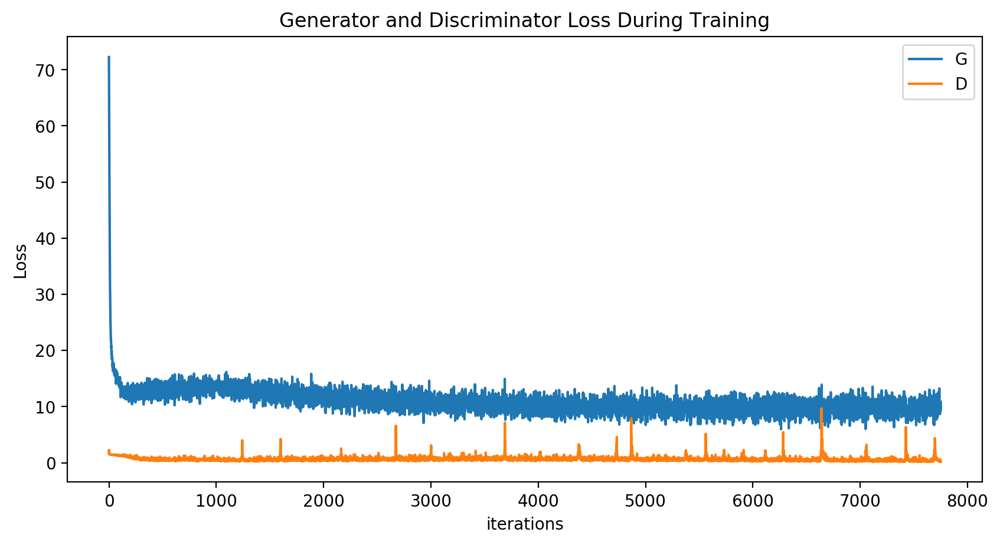

In [21]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(losses_g,label="G")
plt.plot(losses_d,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

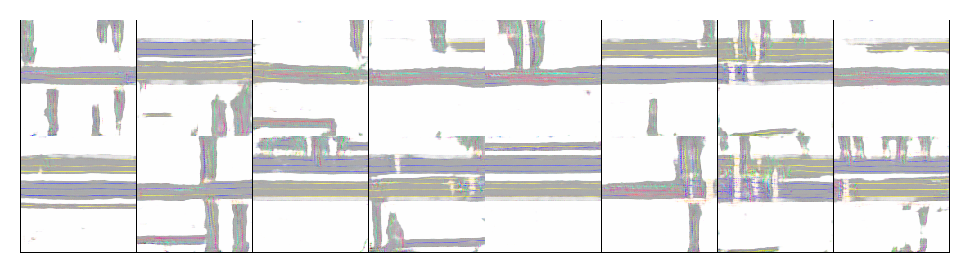

In [22]:
#%%capture
fig = plt.figure(figsize=(6,6))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in intermediate_images]
ani = animation.ArtistAnimation(fig, ims, interval=100, repeat_delay=2000, blit=True)

HTML(ani.to_jshtml())

### Evaluate trained generator model on test data (Qualitative)

In [23]:
labeled_testset = LabeledDataset(image_folder=data_dir,
                                  annotation_file=annotation_csv,
                                  scene_index=labeled_scene_index_test,
                                  img_transform=transforms.Compose([transforms.Resize((256,256)),
                                                                    transforms.ToTensor(),
                                                                    transforms.Normalize(mean=(0.5,), std=(0.5,))
                                                                   ]),
                                  map_transform=transforms.Compose([transforms.ToPILImage(),
                                                                    transforms.Resize(256),
                                                                    transforms.ToTensor()
                                                                   ]),
                                  extra_info=True
                                 )

testloader = torch.utils.data.DataLoader(labeled_testset,
                                          batch_size=1,
                                          shuffle=True,
                                          num_workers=2,
                                          collate_fn=collate_fn,
                                          pin_memory=True)

In [24]:
losses_g_L1_eval = []
inference_images = []

generator.eval()

Generator(
  (model): Sequential(
    (0): ReflectionPad2d((3, 3, 3, 3))
    (1): Conv2d(18, 64, kernel_size=(7, 7), stride=(1, 1))
    (2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): ReLU(inplace=True)
    (4): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (5): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (8): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (9): ReLU(inplace=True)
    (10): ResnetBlock(
      (resnet_block): Sequential(
        (0): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU(inplace=True)
        (3): Dropout(p=0.5, inplace=False)
        (4): Conv2d(256, 256, kernel_size=(3, 3), strid

In [25]:
####################################
############ INFERENCE #############
####################################

for real_18ch, real_map in tqdm(testloader):
    real_18ch = real_18ch.to(device)
    real_map = real_map.to(device)

    """
    GENERATOR INFERENCE
    """
    gen_map = generator(real_18ch)
    loss_g_L1 = criterion_L1(gen_map, real_map)

    """
    COMPILE TRAINING STATISTICS
    """
    losses_g_L1_eval.append(loss_g_L1.item())
    inference_images.append(np.hstack((real_map.cpu().view([3,256,256]), (gen_map.detach().cpu().view([3,256,256])*0.5) + 0.5)))

100%|██████████| 504/504 [00:27<00:00, 18.44it/s]


Animation size has reached 21020322 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


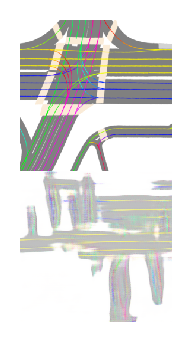

In [26]:
# %%capture
fig = plt.figure(figsize=(4,2))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)).squeeze(), animated=True)] for i in inference_images]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=2000, blit=True)

HTML(ani.to_jshtml())